In [ ]:
!pip install transformers

In [ ]:
import pandas as pd
import numpy as np
import time
import tqdm
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data as data
from sklearn.metrics import f1_score
from torch.utils.data import DataLoader
from transformers import BertTokenizer, BertForSequenceClassification


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:

# Fixing the randomness of CUDA.
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

np.random.seed(42)
torch.manual_seed(42)

DEVICE = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print("PyTorch Version : {}".format(torch.__version__))
print(DEVICE)


worksapce = '/content/drive/MyDrive/liar2/'
model_save = 'LIAR2.pt'
model_name = 'LIAR2'
num_epochs = 10
batch_size = 32
learning_rate = 1e-3
num_classes = 6
padding_idx = 0
metadata_each_dim = 10
print(model_save)
''' col = ['id', 'label', 'statement', 'subject', 'speaker', 'job_title', 'state_info', 'party_affiliation', 'barely_true_counts',
'false_counts', 'half_true_counts', 'mostly_true_counts', 'pants_on_fire_counts', 'context']'''

col = ["id", "label", "statement", "date", "subject", "speaker", "speaker_description",
       "state_info", "true_counts", "mostly_true_counts", "half_true_counts", "mostly_false_counts", "false_counts", "pants_on_fire_counts", "context", "justification"]

label_map = {0: 'pants-fire', 1: 'false', 2: 'barely-true', 3: 'half-true', 4: 'mostly-true', 5: 'true'}
label_convert = {'pants-fire': 0, 'false': 1, 'barely-true': 2, 'half-true': 3, 'mostly-true': 4, 'true':5}

train_data = pd.read_csv(worksapce + 'liar2/train.csv')
test_data = pd.read_csv(worksapce + 'liar2/test.csv')
val_data = pd.read_csv(worksapce + 'liar2/valid.csv')

# Replace NaN values with 'NaN'
train_data[["true_counts", "mostly_true_counts", "half_true_counts", "mostly_false_counts", "false_counts", "pants_on_fire_counts"]] = train_data[["true_counts", "mostly_true_counts", "half_true_counts",
                                                                                                                                                   "mostly_false_counts", "false_counts", "pants_on_fire_counts"]].fillna(0)
train_data.fillna('NaN', inplace=True)

test_data[["true_counts", "mostly_true_counts", "half_true_counts", "mostly_false_counts", "false_counts", "pants_on_fire_counts"]] = test_data[["true_counts", "mostly_true_counts", "half_true_counts",
                                                                                                                                                 "mostly_false_counts", "false_counts", "pants_on_fire_counts"]].fillna(0)
test_data.fillna('NaN', inplace=True)

val_data[["true_counts", "mostly_true_counts", "half_true_counts", "mostly_false_counts", "false_counts", "pants_on_fire_counts"]] = val_data[["true_counts", "mostly_true_counts", "half_true_counts",
                                                                                                                                               "mostly_false_counts", "false_counts", "pants_on_fire_counts"]].fillna(0)
val_data.fillna('NaN', inplace=True)




PyTorch Version : 2.6.0+cu124
cuda
LIAR2.pt


In [ ]:
#Viewing sample train data before preprocessing
train_data.head(5)

,id,label,statement,date,subject,speaker,speaker_description,state_info,true_counts,mostly_true_counts,half_true_counts,mostly_false_counts,false_counts,pants_on_fire_counts,context,justification
0,13847,5,"90 percent of Americans ""support universal bac...","October 2, 2017",government regulation;polls and public opinion...,chris abele,"Chris Abele is Milwaukee County Executive, a p...",wisconsin,1,4,5,3,5,2,a tweet,"""Universal"" is the term for background checks ..."
1,13411,1,Last year was one of the deadliest years ever ...,"May 19, 2017",after the fact;congress;criminal justice;histo...,thom tillis,Thom Tillis is a Republican who serves as U.S....,north carolina,0,2,7,3,2,0,a press release supporting the Back The Blue A...,"Sen. Thom Tillis, a North Carolina Republican,..."
2,10882,0,"Bernie Sanders's plan is ""to raise your taxes ...","October 28, 2015",taxes,chris christie,"Chris Christie announced June 6, 2023 that he ...",national,21,20,27,11,17,8,"Boulder, Colo","Christie said that Sanders’s plan is ""to raise..."
3,20697,4,Voter ID is supported by an overwhelming major...,"December 8, 2021",voter id laws,lee zeldin,Lee Zeldin is a Republican representing New Yo...,new york,1,2,0,0,0,0,a Tweet,Zeldin claimed voter identification requiremen...
4,6095,2,"Says Barack Obama ""robbed Medicare (of) $716 b...","August 12, 2012",federal budget;history;medicare;retirement,mitt romney,Mitt Romney is a U.S. senator from Utah. He ra...,national,31,33,58,35,32,19,"an interview on ""60 Minutes""","Romney said, ""There's only one president that ..."


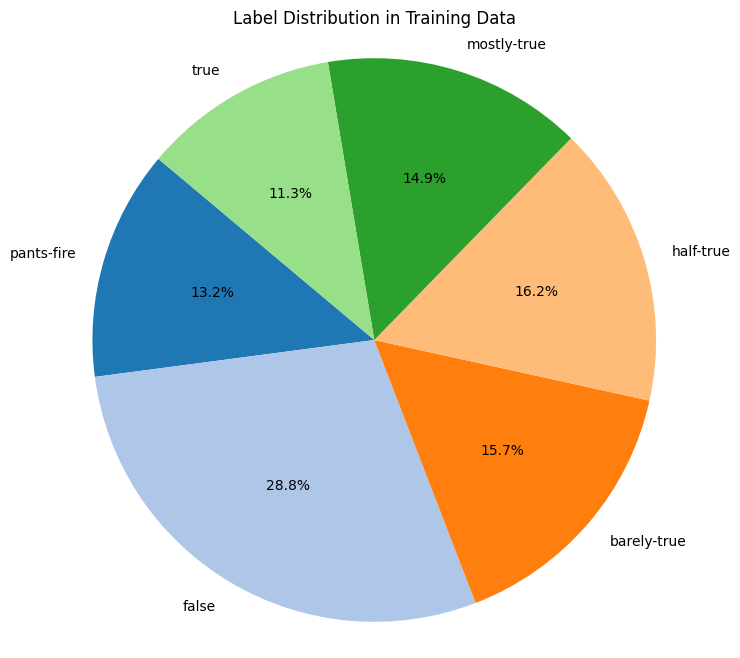

In [ ]:
import matplotlib.pyplot as plt

# Count label frequencies
label_counts = train_data['label'].value_counts().sort_index()

# Map numeric labels to textual names
labels = [label_map[i] for i in label_counts.index]
sizes = label_counts.values

# Plotting the pie chart
plt.figure(figsize=(8, 8))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=140, colors=plt.cm.tab20.colors)
plt.title('Label Distribution in Training Data')
plt.axis('equal')  # Equal aspect ratio ensures pie chart is circular
plt.show()


In [ ]:
def textProcess(input_text, max_length = -1):
    tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
    if max_length == -1:
        tokens = tokenizer(input_text, truncation=True, padding=True)
    else:
        tokens = tokenizer(input_text, truncation=True, padding='max_length', max_length=max_length)
    return tokens
print(textProcess(train_data['statement'].tolist()))



/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

{'input_ids': [[101, 3938, 3867, 1997, 4841, 1000, 2490, 5415, 4281, 14148, 1000, 2005, 3282, 17402, 1012, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [101, 2197, 2095, 2001, 2028, 1997, 1996, 2757, 21292, 2086, 2412, 2005, 2375, 7285, 3738, 1012, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [101, 15941, 12055, 1005, 1055, 2933, 2003, 1000, 2000, 5333, 2115, 7773, 2000, 3938, 3867, 1012, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

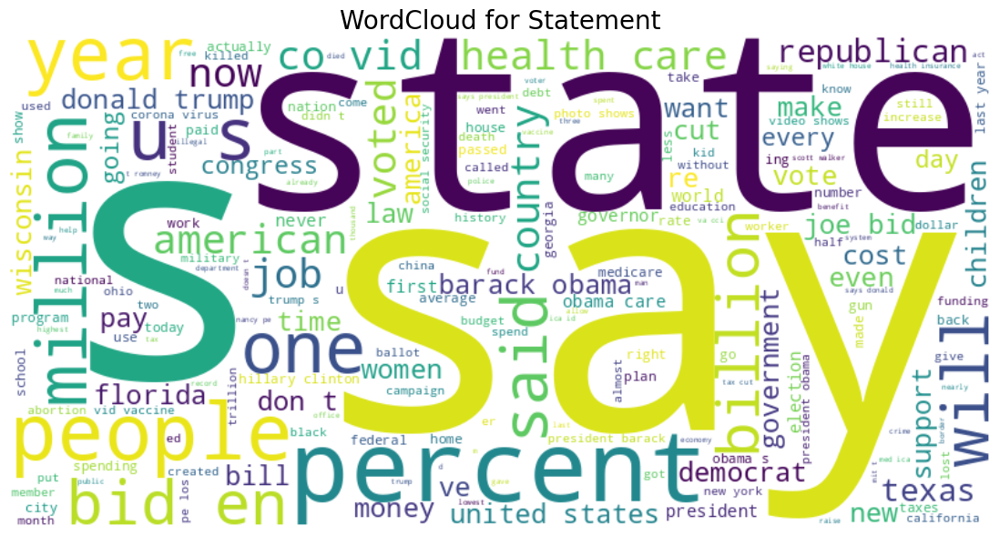

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from transformers import AutoTokenizer

# Initialize your tokenizer (replace with your actual tokenizer model name if needed)
tokenizer = AutoTokenizer.from_pretrained("bert-base-uncased")

def generate_wordcloud_from_statements(data, tokenizer, field="statement"):
    """
    Generate a WordCloud from a specific field in a DataFrame (such as 'statement').

    Parameters:
    - data: pandas DataFrame containing the dataset.
    - tokenizer: HuggingFace tokenizer.
    - field: the column name in the DataFrame that you want to generate WordCloud from (default is "statement").
    """
    all_text = ""

    for statement in data[field]:
        # Tokenize the statement
        tokens = tokenizer.tokenize(statement)
        # Convert tokens back to a readable string and append to all_text
        all_text += " ".join(tokens) + " "

    # Generate WordCloud
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_text)

    # Plot the WordCloud
    plt.figure(figsize=(15, 7))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f"WordCloud for {field.capitalize()}", fontsize=20)
    plt.show()

# Assuming train_data is a DataFrame with a 'statement' column
generate_wordcloud_from_statements(train_data, tokenizer, field="statement")


In [ ]:
from transformers import pipeline
unmasker = pipeline('fill-mask', model='bert-base-uncased')

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


model.safetensors:   0%|          | 0.00/440M [00:00<?, ?B/s]

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForMaskedLM: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'cls.seq_relationship.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing BertForMaskedLM from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForMaskedLM from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Device set to use cuda:0


In [ ]:
unmasker("Artificial Intelligence [MASK] take over the world.")

[{'score': 0.3182397484779358,
  'token': 2064,
  'token_str': 'can',
  'sequence': 'artificial intelligence can take over the world.'},
 {'score': 0.18299631774425507,
  'token': 2097,
  'token_str': 'will',
  'sequence': 'artificial intelligence will take over the world.'},
 {'score': 0.05600127577781677,
  'token': 2000,
  'token_str': 'to',
  'sequence': 'artificial intelligence to take over the world.'},
 {'score': 0.04519487917423248,
  'token': 2015,
  'token_str': '##s',
  'sequence': 'artificial intelligences take over the world.'},
 {'score': 0.045153211802244186,
  'token': 2052,
  'token_str': 'would',
  'sequence': 'artificial intelligence would take over the world.'}]

In [ ]:
# Define a custom dataset for loading the data
class LiarDataset(data.Dataset):
    def __init__(self, data_df, statement, label_onehot, label, date, subject, speaker, speaker_description, state_info,
                    true_counts, mostly_true_counts, half_true_counts, mostly_false_counts,
                    false_counts, pants_on_fire_counts, context, justification):
        self.data_df = data_df
        self.statement = statement
        self.label_onehot = label_onehot
        self.label = label
        self.justification = justification
        self.metadata_text = torch.cat((date.int(), subject.int(), speaker.int(), speaker_description.int(), state_info.int(), context.int()), dim=-1)
        self.metadata_number = torch.cat((torch.tensor(true_counts, dtype=torch.float).unsqueeze(1), torch.tensor(mostly_true_counts, dtype=torch.float).unsqueeze(1),
                                   torch.tensor(half_true_counts, dtype=torch.float).unsqueeze(1), torch.tensor(mostly_false_counts, dtype=torch.float).unsqueeze(1),
                                   torch.tensor(false_counts, dtype=torch.float).unsqueeze(1), torch.tensor(pants_on_fire_counts, dtype=torch.float).unsqueeze(1)), dim=-1)

    def __len__(self):
        return len(self.data_df)

    def __getitem__(self, idx):
        statement = self.statement[idx]
        label_onehot = self.label_onehot[idx]
        label = self.label[idx]
        justification = self.justification[idx]
        metadata_text = self.metadata_text[idx]
        metadata_number = self.metadata_number[idx]
        return statement, label_onehot, label, metadata_text, metadata_number, justification


# Define the data loaders for training and validation
train_text = torch.tensor(textProcess(train_data['statement'].tolist())['input_ids'])
train_justification = torch.tensor(textProcess(train_data['justification'].tolist())['input_ids'])
train_label = torch.nn.functional.one_hot(torch.tensor(train_data['label'].replace(label_convert)), num_classes=6).type(torch.float64)
train_date = torch.tensor(textProcess(train_data['date'].tolist(), metadata_each_dim)['input_ids'])
train_subject = torch.tensor(textProcess(train_data['subject'].tolist(), metadata_each_dim)['input_ids'])
train_speaker = torch.tensor(textProcess(train_data['speaker'].tolist(), metadata_each_dim)['input_ids'])
train_speaker_description = torch.tensor(textProcess(train_data['speaker_description'].tolist(), metadata_each_dim)['input_ids'])
train_state_info = torch.tensor(textProcess(train_data['state_info'].tolist(), metadata_each_dim)['input_ids'])
train_context = torch.tensor(textProcess(train_data['context'].tolist(), metadata_each_dim)['input_ids'])

train_dataset = LiarDataset(train_data, train_text, train_label, torch.tensor(train_data['label'].replace(label_convert)),
                            train_date, train_subject, train_speaker, train_speaker_description, train_state_info,
                            train_data['true_counts'].tolist(), train_data['mostly_true_counts'].tolist(),
                            train_data['half_true_counts'].tolist(), train_data['mostly_false_counts'].tolist(),
                            train_data['false_counts'].tolist(), train_data['pants_on_fire_counts'].tolist(), train_context, train_justification)
train_loader = data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

val_text = torch.tensor(textProcess(val_data['statement'].tolist())['input_ids'])
val_justification = torch.tensor(textProcess(val_data['justification'].tolist())['input_ids'])
val_label = torch.nn.functional.one_hot(torch.tensor(val_data['label'].replace(label_convert)), num_classes=6).type(torch.float64)
val_date = torch.tensor(textProcess(val_data['date'].tolist(), metadata_each_dim)['input_ids'])
val_subject = torch.tensor(textProcess(val_data['subject'].tolist(), metadata_each_dim)['input_ids'])
val_speaker = torch.tensor(textProcess(val_data['speaker'].tolist(), metadata_each_dim)['input_ids'])
val_speaker_description = torch.tensor(textProcess(val_data['speaker_description'].tolist(), metadata_each_dim)['input_ids'])
val_state_info = torch.tensor(textProcess(val_data['state_info'].tolist(), metadata_each_dim)['input_ids'])
val_context = torch.tensor(textProcess(val_data['context'].tolist(), metadata_each_dim)['input_ids'])

val_dataset = LiarDataset(val_data, val_text, val_label, torch.tensor(val_data['label'].replace(label_convert)),
                          val_date, val_subject, val_speaker, val_speaker_description, val_state_info,
                          val_data['true_counts'].tolist(), val_data['mostly_true_counts'].tolist(),
                          val_data['half_true_counts'].tolist(), val_data['mostly_false_counts'].tolist(),
                          val_data['false_counts'].tolist(), val_data['pants_on_fire_counts'].tolist(), val_context, val_justification)
val_loader = data.DataLoader(val_dataset, batch_size=batch_size)

test_text = torch.tensor(textProcess(test_data['statement'].tolist())['input_ids'])
test_justification = torch.tensor(textProcess(test_data['justification'].tolist())['input_ids'])
test_label = torch.nn.functional.one_hot(torch.tensor(test_data['label'].replace(label_convert)), num_classes=6).type(torch.float64)
test_date = torch.tensor(textProcess(test_data['date'].tolist(), metadata_each_dim)['input_ids'])
test_subject = torch.tensor(textProcess(test_data['subject'].tolist(), metadata_each_dim)['input_ids'])
test_speaker = torch.tensor(textProcess(test_data['speaker'].tolist(), metadata_each_dim)['input_ids'])
test_speaker_description = torch.tensor(textProcess(test_data['speaker_description'].tolist(), metadata_each_dim)['input_ids'])
test_state_info = torch.tensor(textProcess(test_data['state_info'].tolist(), metadata_each_dim)['input_ids'])
test_context = torch.tensor(textProcess(test_data['context'].tolist(), metadata_each_dim)['input_ids'])

test_dataset = LiarDataset(test_data, test_text, test_label, torch.tensor(test_data['label'].replace(label_convert)),
                          test_date, test_subject, test_speaker, test_speaker_description, test_state_info,
                          test_data['true_counts'].tolist(), test_data['mostly_true_counts'].tolist(),
                          test_data['half_true_counts'].tolist(), test_data['mostly_false_counts'].tolist(),
                          test_data['false_counts'].tolist(), test_data['pants_on_fire_counts'].tolist(), test_context, test_justification)
test_loader = data.DataLoader(test_dataset, batch_size=batch_size)




In [ ]:
print("Processing training data...")
train_text = torch.tensor(textProcess(train_data['statement'].tolist())['input_ids'])
print("Train text shape:", train_text.shape)

train_justification = torch.tensor(textProcess(train_data['justification'].tolist())['input_ids'])
print("Train justification shape:", train_justification.shape)

train_label = torch.nn.functional.one_hot(torch.tensor(train_data['label'].replace(label_convert)), num_classes=6).type(torch.float64)
print("Train label shape (one-hot):", train_label.shape)

train_date = torch.tensor(textProcess(train_data['date'].tolist(), metadata_each_dim)['input_ids'])
# (Add similar print statements for subject, speaker, etc.)



Processing training data...
Train text shape: torch.Size([18369, 113])
Train justification shape: torch.Size([18369, 512])
Train label shape (one-hot): torch.Size([18369, 6])


In [ ]:
print(test_context)
print(test_justification)
print (train_context)
print (train_justification)
print(val_context)
print(val_justification)

tensor([[  101,  1037,  2695,  ...,     0,     0,     0],
        [  101,  9130,  8466,  ...,     0,     0,     0],
        [  101,  2019, 16021,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  9130,  ...,     0,     0,     0],
        [  101,  1037,  3780,  ...,     0,     0,     0],
        [  101,  1037,  9130,  ...,     0,     0,     0]])
tensor([[  101,  1000, 16562,  ...,     0,     0,     0],
        [  101,  2591,  2865,  ...,     0,     0,     0],
        [  101,  1996,  3746,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  2591,  ...,     0,     0,     0],
        [  101,  1996,  2755,  ...,     0,     0,     0],
        [  101,  1000,  2057,  ...,     0,     0,     0]])
tensor([[  101,  1037,  1056,  ...,     0,     0,     0],
        [  101,  1037,  2811,  ...,  1996,  2630,   102],
        [  101, 13264,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2019,  4357,  ...,     0,     0,     0],
        [  101,  2019,  4357,  

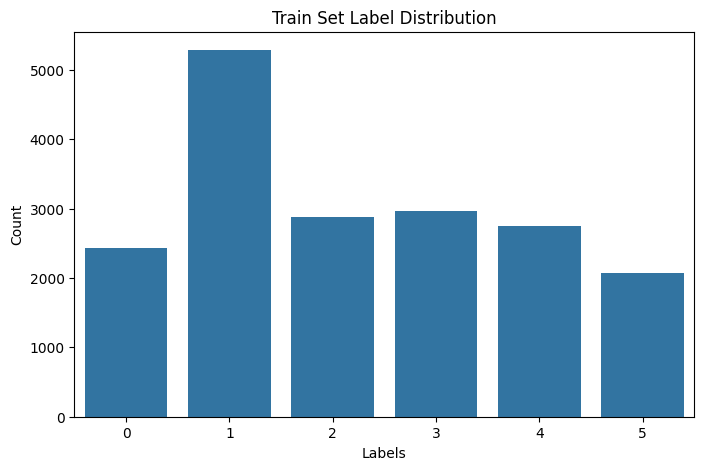

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_label_distribution(data, title="Label Distribution"):
    plt.figure(figsize=(8,5))
    sns.countplot(x='label', data=data)
    plt.title(title)
    plt.xlabel("Labels")
    plt.ylabel("Count")

    plt.show()

plot_label_distribution(train_data, "Train Set Label Distribution")


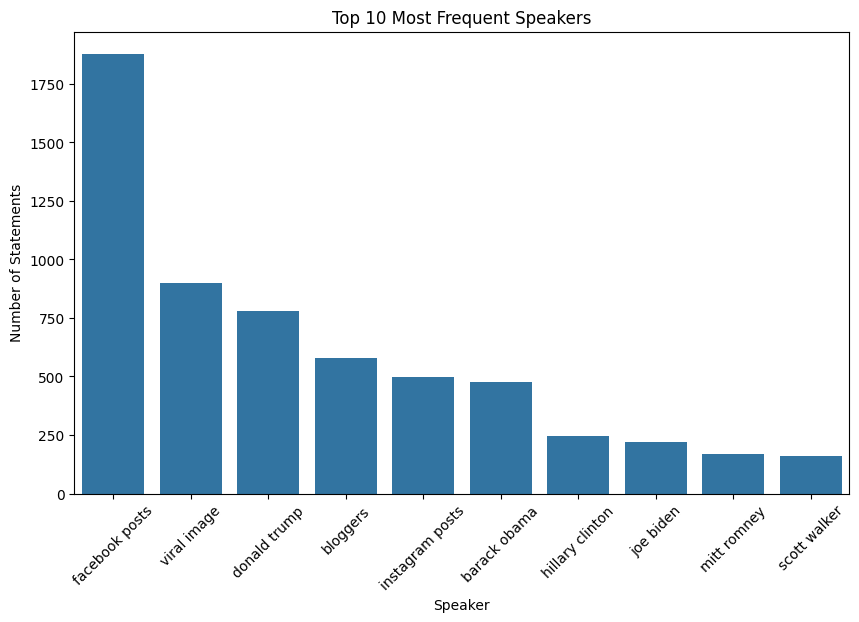

In [ ]:
top_speakers = train_data['speaker'].value_counts().nlargest(10)
plt.figure(figsize=(10,6))
sns.barplot(x=top_speakers.index, y=top_speakers.values)
plt.xticks(rotation=45)
plt.title("Top 10 Most Frequent Speakers")
plt.xlabel("Speaker")
plt.ylabel("Number of Statements")
plt.show()


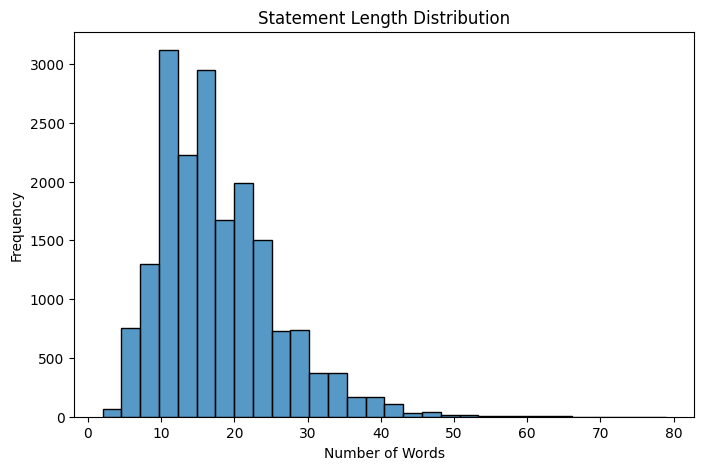

In [ ]:
statement_lengths = train_data['statement'].apply(lambda x: len(x.split()))
plt.figure(figsize=(8,5))
sns.histplot(statement_lengths, bins=30)
plt.title("Statement Length Distribution")
plt.xlabel("Number of Words")
plt.ylabel("Frequency")
plt.show()


In [ ]:
class FuzzyLayer(nn.Module):
    def __init__(self, input_dim, membership_num):
        super(FuzzyLayer, self).__init__()

        # input_dim: feature number of the dataset
        # membership_num: number of membership function, also known as the class number

        self.input_dim = input_dim
        self.membership_num = membership_num

        self.membership_miu = nn.Parameter(torch.Tensor(self.membership_num, self.input_dim).to(DEVICE), requires_grad=True)
        self.membership_sigma = nn.Parameter(torch.Tensor(self.membership_num, self.input_dim).to(DEVICE), requires_grad=True)

        nn.init.xavier_uniform_(self.membership_miu)
        nn.init.ones_(self.membership_sigma)

    def forward(self, input_seq):
        batch_size = input_seq.size()[0]
        input_seq_exp = input_seq.unsqueeze(1).expand(batch_size, self.membership_num, self.input_dim)
        membership_miu_exp = self.membership_miu.unsqueeze(0).expand(batch_size, self.membership_num, self.input_dim)
        membership_sigma_exp = self.membership_sigma.unsqueeze(0).expand(batch_size, self.membership_num, self.input_dim)

        fuzzy_membership = torch.mean(torch.exp((-1 / 2) * ((input_seq_exp - membership_miu_exp) / membership_sigma_exp) ** 2), dim=-1)
        return fuzzy_membership




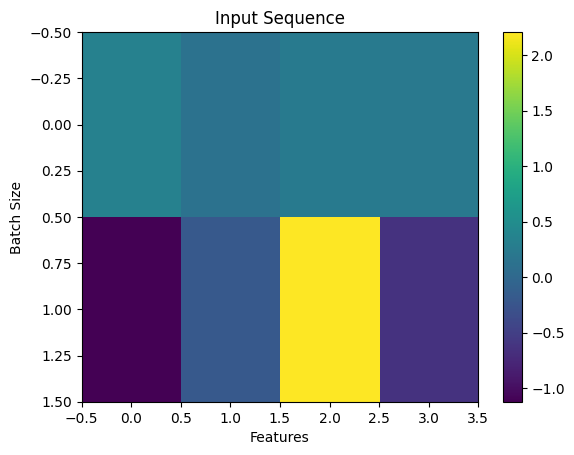

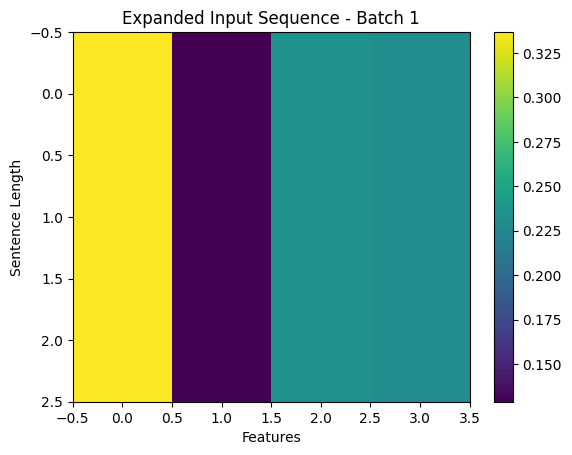

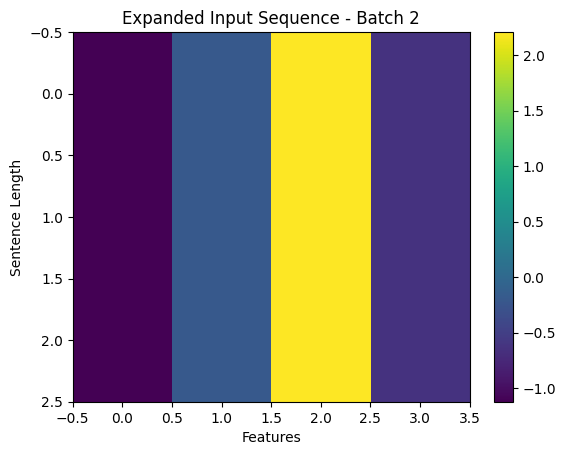

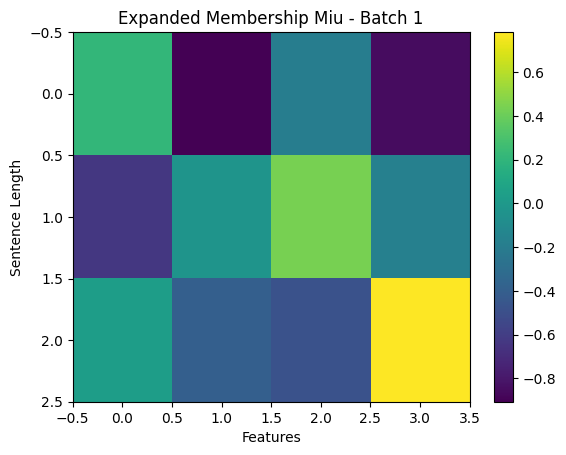

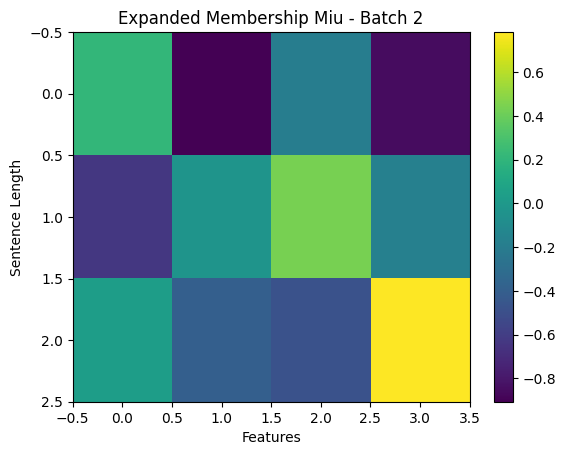

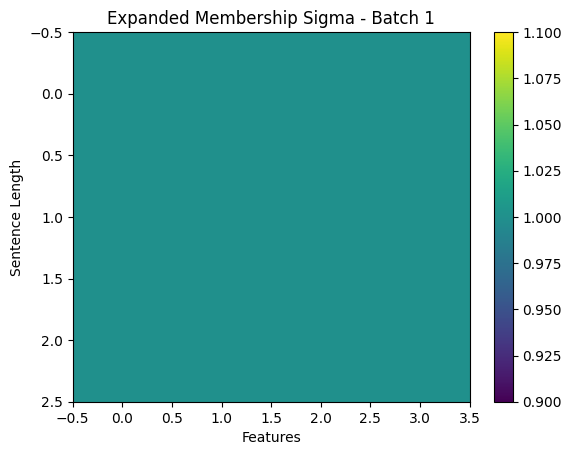

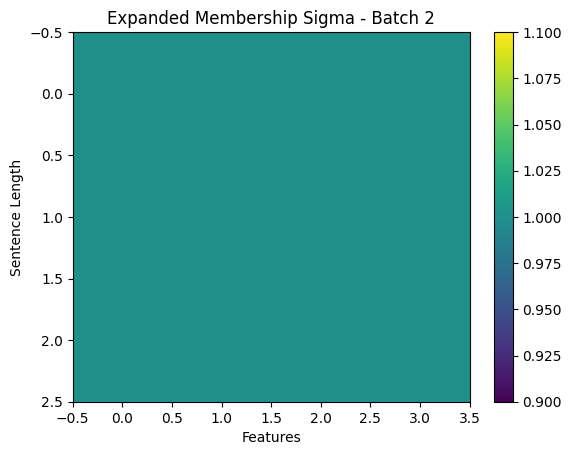

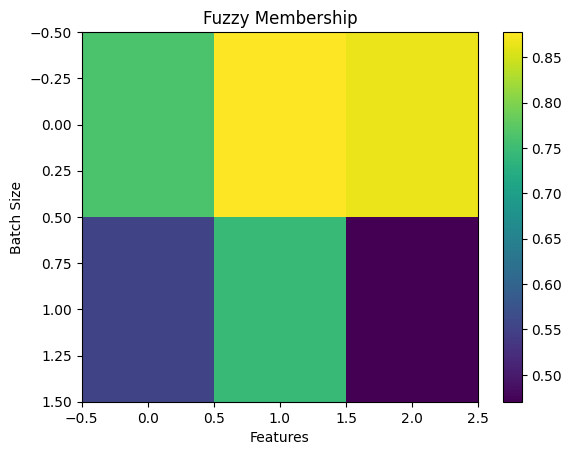

Input Sequence Shape: torch.Size([2, 4])
Expanded Input Sequence Shape: torch.Size([2, 3, 4])
Expanded Membership Miu Shape: torch.Size([2, 3, 4])
Expanded Membership Sigma Shape: torch.Size([2, 3, 4])
Fuzzy Membership Shape: torch.Size([2, 3])


In [ ]:
import torch
import torch.nn as nn
import matplotlib.pyplot as plt

# Device configuration (for running on GPU if available)
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

class FuzzyLayer(nn.Module):
    def __init__(self, input_dim, membership_num):
        super(FuzzyLayer, self).__init__()

        # input_dim: feature number of the dataset
        # membership_num: number of membership functions, also known as the class number

        self.input_dim = input_dim
        self.membership_num = membership_num

        # Define membership parameters
        self.membership_miu = nn.Parameter(torch.Tensor(self.membership_num, self.input_dim).to(DEVICE), requires_grad=True)
        self.membership_sigma = nn.Parameter(torch.Tensor(self.membership_num, self.input_dim).to(DEVICE), requires_grad=True)

        # Initialize membership parameters
        nn.init.xavier_uniform_(self.membership_miu)
        nn.init.ones_(self.membership_sigma)

    def forward(self, input_seq):
        batch_size = input_seq.size()[0]

        # Expand the input sequence for fuzzy computation
        input_seq_exp = input_seq.unsqueeze(1).expand(batch_size, self.membership_num, self.input_dim)
        membership_miu_exp = self.membership_miu.unsqueeze(0).expand(batch_size, self.membership_num, self.input_dim)
        membership_sigma_exp = self.membership_sigma.unsqueeze(0).expand(batch_size, self.membership_num, self.input_dim)

        # Compute fuzzy membership values
        fuzzy_membership = torch.mean(torch.exp((-1 / 2) * ((input_seq_exp - membership_miu_exp) / membership_sigma_exp) ** 2), dim=-1)

        # Visualizing the intermediate results
        self.plot_tensor(input_seq, "Input Sequence")
        self.plot_tensor(input_seq_exp, "Expanded Input Sequence")
        self.plot_tensor(membership_miu_exp, "Expanded Membership Miu")
        self.plot_tensor(membership_sigma_exp, "Expanded Membership Sigma")
        self.plot_tensor(fuzzy_membership, "Fuzzy Membership")

        return fuzzy_membership

    def plot_tensor(self, tensor, title):
        """ Function to visualize tensor at each stage """
        # Only plot if the tensor is 2D or 3D (to avoid errors with larger tensors)
        if tensor.dim() == 2:
            # Plot 2D data (e.g., batch_size, sentence_len)
            plt.imshow(tensor.detach().cpu().numpy(), aspect='auto', cmap='viridis')
            plt.colorbar()
            plt.title(title)
            plt.xlabel('Features')
            plt.ylabel('Batch Size')
            plt.show()

        elif tensor.dim() == 3:
            # Plot 3D data (e.g., batch_size, emb_dim, sent_len)
            for i in range(tensor.size(0)):  # Iterate over batch size
                plt.imshow(tensor[i].detach().cpu().numpy(), aspect='auto', cmap='viridis')
                plt.colorbar()
                plt.title(f"{title} - Batch {i+1}")
                plt.xlabel('Features')
                plt.ylabel('Sentence Length')
                plt.show()


# Create a dummy input tensor (batch_size=2, input_dim=4)
input_seq = torch.randn(2, 4).to(DEVICE)  # Example: batch_size=2, input_dim=4

# Initialize the FuzzyLayer
fuzzy_layer = FuzzyLayer(input_dim=4, membership_num=3).to(DEVICE)

# Forward pass with the input tensor and get the fuzzy membership
fuzzy_membership = fuzzy_layer(input_seq)

# Now, let's print the intermediate tensor shapes to ensure everything is correct
print(f"Input Sequence Shape: {input_seq.shape}")
input_seq_exp = input_seq.unsqueeze(1).expand(2, 3, 4)
print(f"Expanded Input Sequence Shape: {input_seq_exp.shape}")
membership_miu_exp = fuzzy_layer.membership_miu.unsqueeze(0).expand(2, 3, 4)
print(f"Expanded Membership Miu Shape: {membership_miu_exp.shape}")
membership_sigma_exp = fuzzy_layer.membership_sigma.unsqueeze(0).expand(2, 3, 4)
print(f"Expanded Membership Sigma Shape: {membership_sigma_exp.shape}")
fuzzy_membership = torch.mean(torch.exp((-1 / 2) * ((input_seq_exp - membership_miu_exp) / membership_sigma_exp) ** 2), dim=-1)
print(f"Fuzzy Membership Shape: {fuzzy_membership.shape}")


In [ ]:

class TextCNN(nn.Module):
    def __init__(self, vocab_size, embedding_dim, n_filters, filter_sizes, output_dim, dropout, pad_idx):
        super().__init__()

        # Define the embedding layer
        self.embedding = nn.Embedding(vocab_size, embedding_dim, padding_idx=pad_idx)

        # Define the convolutional layers (one for each filter size)
        self.convs = nn.ModuleList([
            nn.Conv1d(in_channels=embedding_dim, out_channels=n_filters, kernel_size=fs)
            for fs in filter_sizes
        ])

        # Fully connected layer
        self.fc = nn.Linear(len(filter_sizes) * n_filters, output_dim)

        # Dropout layer
        self.dropout = nn.Dropout(dropout)

    def forward(self, text):
        # Text: [batch size, sent len]
        embedded = self.embedding(text)
        print("Embedded shape:", embedded.shape)
        # Embedded: [batch size, sent len, emb dim]

        embedded = embedded.permute(0, 2, 1)  # Change shape to [batch size, emb dim, sent len]
        print("Permuted embedded shape:", embedded.shape)
        # Embedded: [batch size, emb dim, sent len]

        # Apply each convolution layer
        conved = [F.relu(conv(embedded)) for conv in self.convs]
        for i, conv_output in enumerate(conved):
            print(f"Convolution {i+1} output shape:", conv_output.shape)
        # conved_n = [batch size, n_filters, sent len - filter_sizes[n] + 1]

        # Apply max pooling to each convolution result
        pooled = [F.max_pool1d(conv, conv.shape[2]).squeeze(2) for conv in conved]
        for i, pool_output in enumerate(pooled):
            print(f"Max pooled {i+1} output shape:", pool_output.shape)
        # pooled_n = [batch size, n_filters]

        # Concatenate the pooled outputs from all filter sizes
        cat = self.dropout(torch.cat(pooled, dim=1))
        print("Concatenated pooled output shape:", cat.shape)
        # cat = [batch size, n_filters * len(filter_sizes)]

        # Pass through the fully connected layer
        output = self.fc(cat)
        print("Final output shape:", output.shape)
        return output

# Create a dummy input tensor (batch_size=2, sent_len=10)
text = torch.randint(0, 100, (2, 10))  # Example: batch_size=2, sentence length=10, vocab_size=100

# Initialize the TextCNN model
model = TextCNN(vocab_size=100, embedding_dim=50, n_filters=10, filter_sizes=[3, 4, 5], output_dim=2, dropout=0.5, pad_idx=0)

# Forward pass with the input tensor
output = model(text)


Embedded shape: torch.Size([2, 10, 50])
Permuted embedded shape: torch.Size([2, 50, 10])
Convolution 1 output shape: torch.Size([2, 10, 8])
Convolution 2 output shape: torch.Size([2, 10, 7])
Convolution 3 output shape: torch.Size([2, 10, 6])
Max pooled 1 output shape: torch.Size([2, 10])
Max pooled 2 output shape: torch.Size([2, 10])
Max pooled 3 output shape: torch.Size([2, 10])
Concatenated pooled output shape: torch.Size([2, 30])
Final output shape: torch.Size([2, 2])


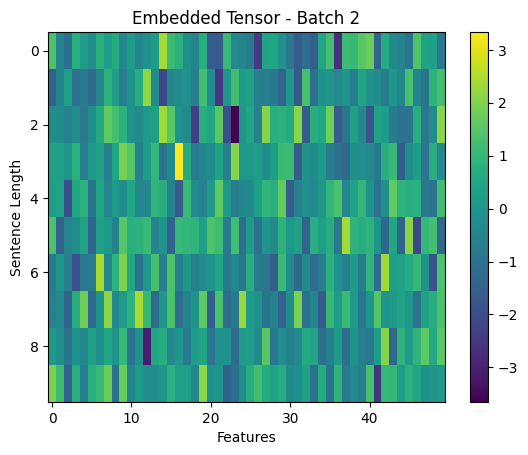

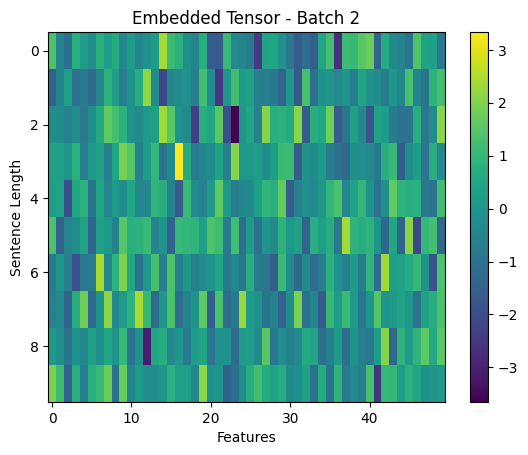

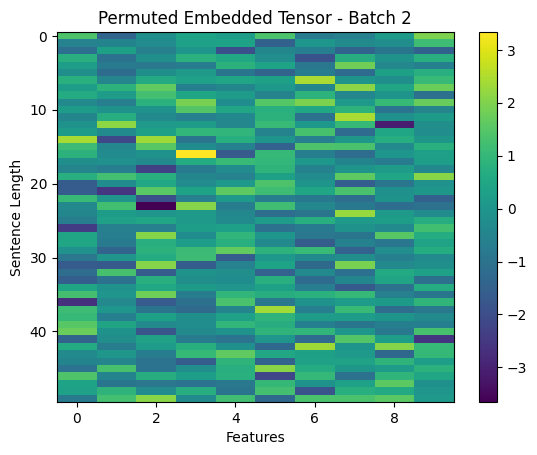

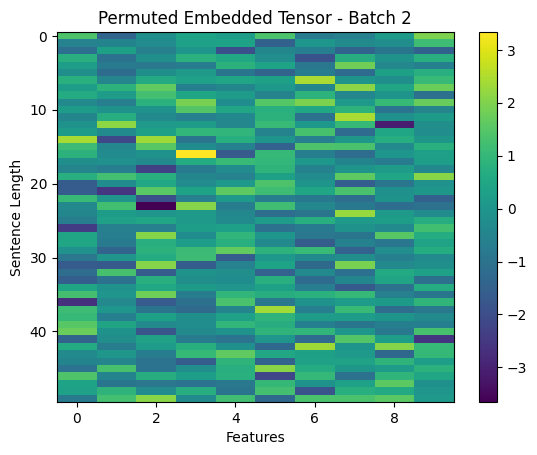

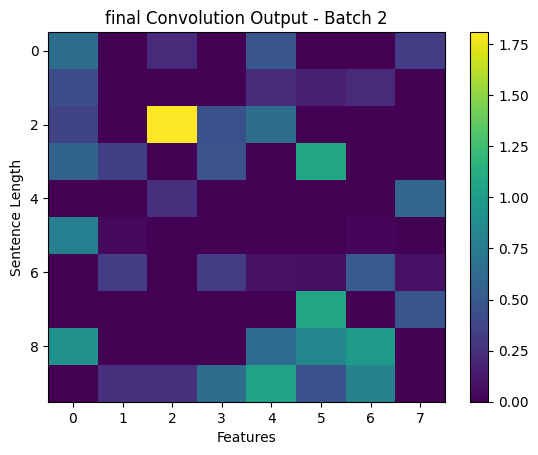

...

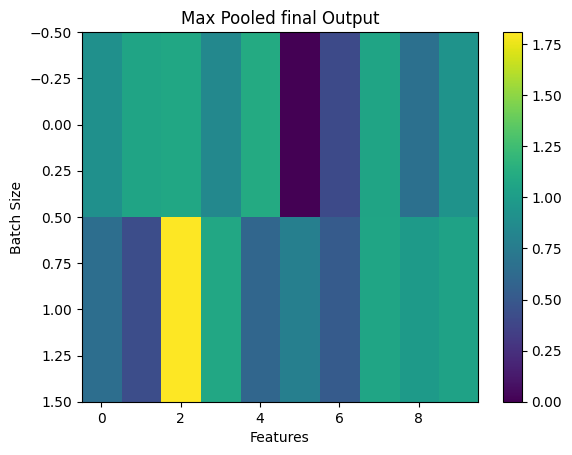

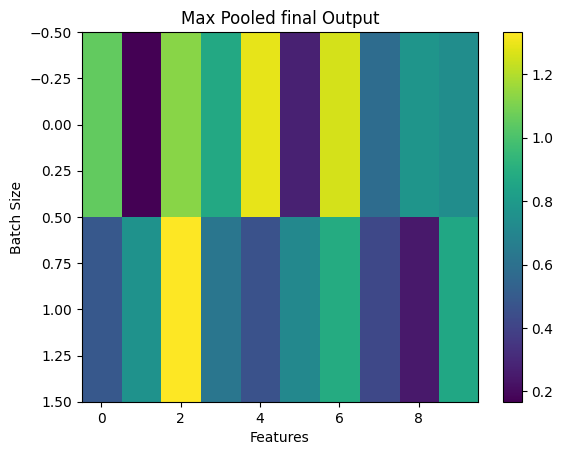

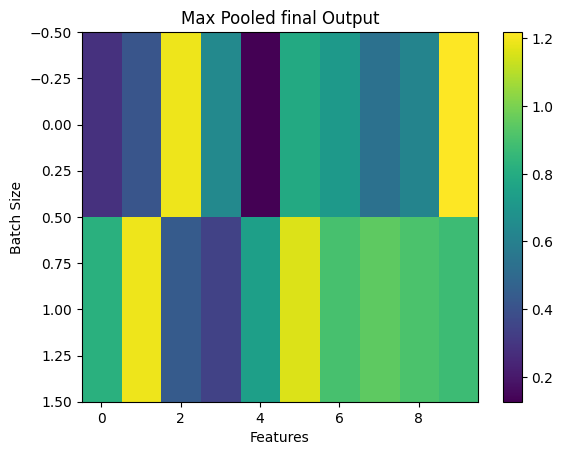

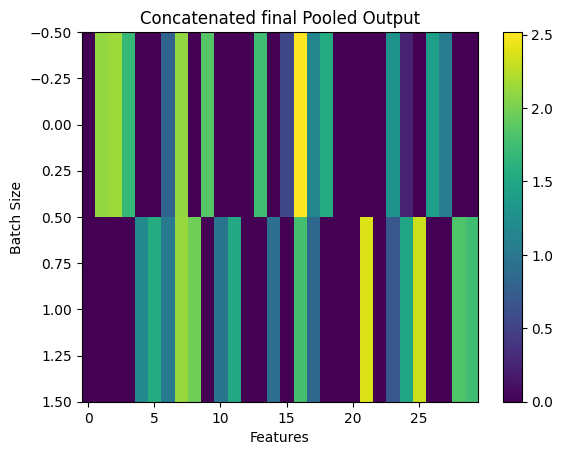

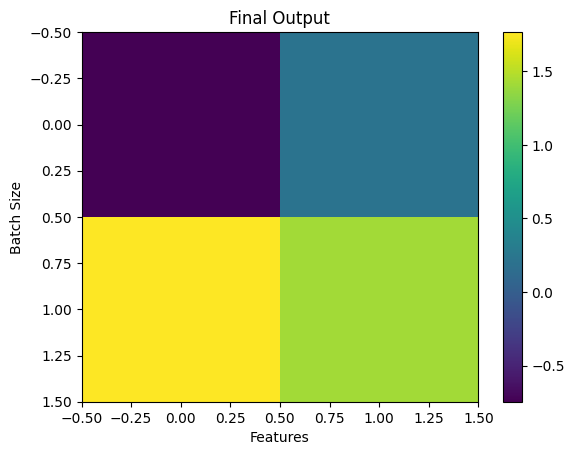

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt

class TextCNN(nn.Module):
    def __init__(self, vocab_size, embedding_dim, n_filters, filter_sizes, output_dim, dropout, pad_idx):
        super().__init__()

        self.embedding = nn.Embedding(vocab_size, embedding_dim, padding_idx=pad_idx)
        self.convs = nn.ModuleList([
            nn.Conv1d(in_channels=embedding_dim, out_channels=n_filters, kernel_size=fs)
            for fs in filter_sizes
        ])
        self.fc = nn.Linear(len(filter_sizes) * n_filters, output_dim)
        self.dropout = nn.Dropout(dropout)

    def forward(self, text):
        # Text: [batch size, sent len]
        embedded = self.embedding(text)
        self.plot_tensor(embedded, "Embedded Tensor")

        embedded = embedded.permute(0, 2, 1)  # Change shape to [batch size, emb dim, sent len]
        self.plot_tensor(embedded, "Permuted Embedded Tensor")

        conved = [F.relu(conv(embedded)) for conv in self.convs]
        for i, conv_output in enumerate(conved):
            self.plot_tensor(conv_output, f"final Convolution Output")

        pooled = [F.max_pool1d(conv, conv.shape[2]).squeeze(2) for conv in conved]
        for i, pool_output in enumerate(pooled):
            self.plot_tensor(pool_output, f"Max Pooled final Output")

        cat = self.dropout(torch.cat(pooled, dim=1))
        self.plot_tensor(cat, "Concatenated final Pooled Output")

        output = self.fc(cat)
        self.plot_tensor(output, "Final Output")

        return output

    def plot_tensor(self, tensor, title):
        """ Function to visualize tensor at each stage """
        # Only plot if the tensor is 2D or 3D (to avoid errors with larger tensors)
        if tensor.dim() == 2:
            # Plot 2D data (e.g., batch_size, sentence_len)
            plt.imshow(tensor.detach().cpu().numpy(), aspect='auto', cmap='viridis')
            plt.colorbar()
            plt.title(title)
            plt.xlabel('Features')
            plt.ylabel('Batch Size')
            plt.show()

        elif tensor.dim() == 3:
            # Plot 3D data (e.g., batch_size, emb_dim, sent_len)
            for i in range(tensor.size(0)):  # Iterate over batch size
                plt.imshow(tensor[tensor.size(0)-1].detach().cpu().numpy(), aspect='auto', cmap='viridis')
                plt.colorbar()
                plt.title(f"{title} - Batch {tensor.size(0)}")
                plt.xlabel('Features')
                plt.ylabel('Sentence Length')
                plt.show()

# Create a dummy input tensor (batch_size=2, sent_len=10)
text = torch.randint(0, 100, (2, 10))  # Example: batch_size=2, sentence length=10, vocab_size=100

# Initialize the TextCNN model
model = TextCNN(vocab_size=100, embedding_dim=50, n_filters=10, filter_sizes=[3, 4, 5], output_dim=2, dropout=0.5, pad_idx=0)

# Forward pass with the input tensor
output = model(text)



Input Shape: torch.Size([4, 10])
After Embedding: torch.Size([4, 128])


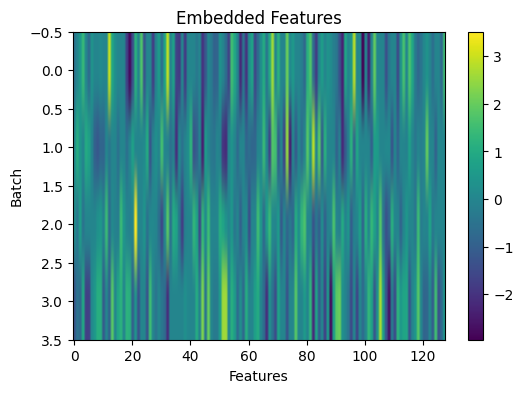

After Reshape for Conv1D: torch.Size([4, 128, 1])
After Conv1D: torch.Size([4, 32, 1])


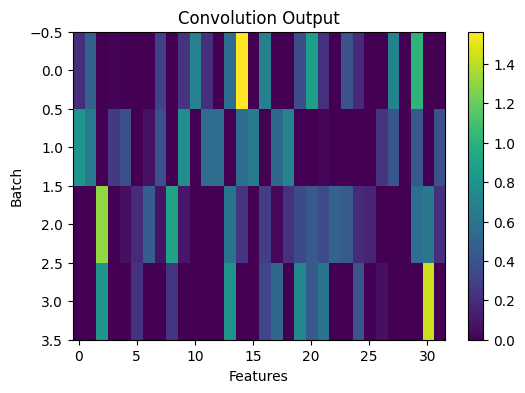

After Reshape for LSTM: torch.Size([4, 1, 32])
LSTM Outputs: torch.Size([4, 1, 128])
LSTM Hidden: torch.Size([2, 1, 64])
LSTM Cell: torch.Size([2, 1, 64])


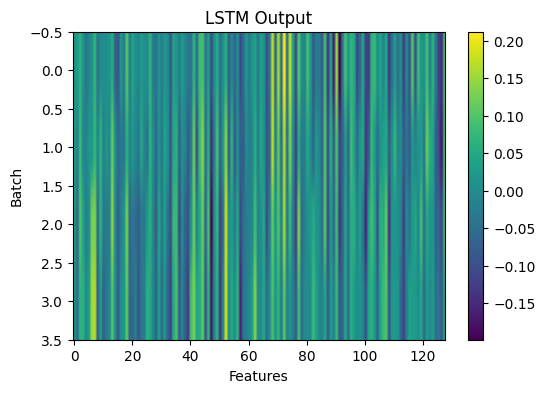

Final Output Shape: torch.Size([4, 3])


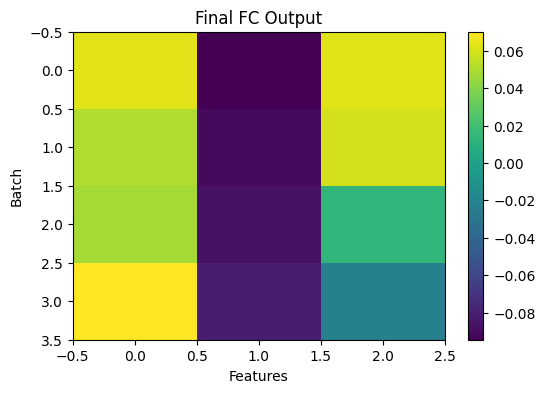

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt

class CNNBiLSTM(nn.Module):
    def __init__(self, input_dim, embedding_dim, hidden_dim, output_dim, n_layers, bidirectional, dropout):
        super().__init__()

        self.embedding = nn.Linear(input_dim, embedding_dim)
        self.conv = nn.Conv1d(in_channels=embedding_dim, out_channels=32, kernel_size=1)
        self.rnn = nn.LSTM(32,
                           hidden_dim,
                           num_layers=n_layers,
                           bidirectional=bidirectional,
                           dropout=dropout if n_layers > 1 else 0)
        self.fc = nn.Linear(hidden_dim * 2, output_dim)
        self.dropout = nn.Dropout(dropout)

    def forward(self, metadata):
        print(f"\nInput Shape: {metadata.shape}")

        # Linear embedding + dropout
        embedded = self.dropout(self.embedding(metadata))
        print(f"After Embedding: {embedded.shape}")
        self.visualize_tensor(embedded, "Embedded Features")

        # Reshape for CNN (CNN expects [batch, channels, sequence])
        embedded = torch.reshape(embedded, (metadata.size(0), 128, 1))
        print(f"After Reshape for Conv1D: {embedded.shape}")

        # Conv1D + ReLU
        conved = F.relu(self.conv(embedded))
        print(f"After Conv1D: {conved.shape}")
        self.visualize_tensor(conved.squeeze(-1), "Convolution Output")

        # Flatten for LSTM input
        conved = torch.reshape(conved, (metadata.size(0), 1, 32))  # (batch, seq_len=1, feature_dim)
        print(f"After Reshape for LSTM: {conved.shape}")

        # LSTM
        outputs, (hidden, cell) = self.rnn(conved)
        print(f"LSTM Outputs: {outputs.shape}")
        print(f"LSTM Hidden: {hidden.shape}")
        print(f"LSTM Cell: {cell.shape}")
        self.visualize_tensor(outputs.squeeze(1), "LSTM Output")

        # Final fully connected
        output = self.fc(outputs.squeeze(1))
        print(f"Final Output Shape: {output.shape}")
        self.visualize_tensor(output, "Final FC Output")

        return output

    def visualize_tensor(self, tensor, title="Tensor"):
        """ Visualizes a 2D tensor as a heatmap (batch_size x features) """
        if tensor.dim() == 2:
            plt.figure(figsize=(6, 4))
            plt.imshow(tensor.detach().cpu().numpy(), cmap='viridis', aspect='auto')
            plt.colorbar()
            plt.title(title)
            plt.xlabel("Features")
            plt.ylabel("Batch")
            plt.show()

# Example: Test the model with dummy data
if __name__ == "__main__":
    input_dim = 10
    model = CNNBiLSTM(input_dim=input_dim, embedding_dim=128, hidden_dim=64, output_dim=3,
                      n_layers=1, bidirectional=True, dropout=0.3)

    dummy_input = torch.randn(4, input_dim)  # batch size = 4
    output = model(dummy_input)


In [ ]:
class FuzzyLayer(nn.Module):
    def __init__(self, input_dim, membership_num):
        super(FuzzyLayer, self).__init__()

        # input_dim: feature number of the dataset
        # membership_num: number of membership function, also known as the class number

        self.input_dim = input_dim
        self.membership_num = membership_num

        self.membership_miu = nn.Parameter(torch.Tensor(self.membership_num, self.input_dim).to(DEVICE), requires_grad=True)
        self.membership_sigma = nn.Parameter(torch.Tensor(self.membership_num, self.input_dim).to(DEVICE), requires_grad=True)

        nn.init.xavier_uniform_(self.membership_miu)
        nn.init.ones_(self.membership_sigma)

    def forward(self, input_seq):
        batch_size = input_seq.size()[0]
        input_seq_exp = input_seq.unsqueeze(1).expand(batch_size, self.membership_num, self.input_dim)
        membership_miu_exp = self.membership_miu.unsqueeze(0).expand(batch_size, self.membership_num, self.input_dim)
        membership_sigma_exp = self.membership_sigma.unsqueeze(0).expand(batch_size, self.membership_num, self.input_dim)

        fuzzy_membership = torch.mean(torch.exp((-1 / 2) * ((input_seq_exp - membership_miu_exp) / membership_sigma_exp) ** 2), dim=-1)
        return fuzzy_membership



class TextCNN(nn.Module):
    def __init__(self, vocab_size, embedding_dim, n_filters, filter_sizes, output_dim, dropout, pad_idx):
        super().__init__()

        self.embedding = nn.Embedding(vocab_size, embedding_dim, padding_idx = pad_idx)
        self.convs = nn.ModuleList([
                                    nn.Conv1d(in_channels = embedding_dim,
                                              out_channels = n_filters,
                                              kernel_size = fs)
                                    for fs in filter_sizes
                                    ])
        self.fc = nn.Linear(len(filter_sizes) * n_filters, output_dim)
        self.dropout = nn.Dropout(dropout)

    def forward(self, text):
        #text = [batch size, sent len]
        embedded = self.embedding(text)
        #embedded = [batch size, sent len, emb dim]

        embedded = embedded.permute(0, 2, 1)
        #embedded = [batch size, emb dim, sent len]

        conved = [F.relu(conv(embedded)) for conv in self.convs]
        #conved_n = [batch size, n_filters, sent len - filter_sizes[n] + 1]

        pooled = [F.max_pool1d(conv, conv.shape[2]).squeeze(2) for conv in conved]
        #pooled_n = [batch size, n_filters]

        cat = self.dropout(torch.cat(pooled, dim = 1))
        #cat = [batch size, n_filters * len(filter_sizes)]

        return self.fc(cat)

class CNNBiLSTM(nn.Module):
    def __init__(self, input_dim, embedding_dim, hidden_dim, output_dim, n_layers, bidirectional, dropout):
        super().__init__()

        self.embedding = nn.Linear(input_dim, embedding_dim)
        self.conv = nn.Conv1d(in_channels=embedding_dim, out_channels=32, kernel_size=1)
        self.rnn = nn.LSTM(32,
                           hidden_dim,
                           num_layers=n_layers,
                           bidirectional=bidirectional,
                           dropout=dropout)
        self.fc = nn.Linear(hidden_dim * 2, output_dim)
        self.dropout = nn.Dropout(dropout)

    def forward(self, metadata):
        #metadata = [batch size, metadata dim]

        embedded = self.dropout(self.embedding(metadata))
        #embedded = [batch size, metadata dim, emb dim]

        embedded = torch.reshape(embedded, (metadata.size(0), 128, 1))

        conved = F.relu(self.conv(embedded))
        #conved = [batch size, n_filters, metadata dim - filter_sizes[n] + 1]

        conved = torch.reshape(conved, (metadata.size(0), 32))

        outputs, (hidden, cell) = self.rnn(conved)
        #outputs = [metadata dim - filter_sizes[n] + 1, batch size, hid dim * num directions]
        #hidden = [num layers * num directions, batch size, hid dim]
        #cell = [num layers * num directions, batch size, hid dim]

        #concat the final forward (hidden[-2,:,:]) and backward (hidden[-1,:,:]) hidden layers
        #and apply dropout
        # hidden = self.dropout(torch.cat((hidden[-1,:], hidden[0,:]), dim = -1))
        #hidden = [batch size, hid dim * num directions]

        return self.fc(outputs)



In [ ]:
class LiarModel(nn.Module):
    def __init__(self, vocab_size, embedding_dim, n_filters, filter_sizes, output_dim, dropout, padding_idx, input_dim, input_dim_metadata, hidden_dim, n_layers, bidirectional):
        super().__init__()

        self.textcnn = TextCNN(vocab_size, embedding_dim, n_filters, filter_sizes, output_dim, dropout, padding_idx)
        self.justification_cnn = TextCNN(vocab_size, embedding_dim, n_filters, filter_sizes, output_dim, dropout, padding_idx)
        self.textcnn2 = TextCNN(vocab_size, input_dim, n_filters, filter_sizes, output_dim, dropout, padding_idx)
        self.cnn_bilstm = CNNBiLSTM(input_dim_metadata, embedding_dim, hidden_dim, output_dim, n_layers, bidirectional, dropout)
        self.fuzzy = FuzzyLayer(output_dim, output_dim)
        self.fuse = nn.Linear(output_dim * 5, output_dim)

    def forward(self, text, metadata_text, metadata_number, justification):
        #text = [batch size, sent len]
        #metadata = [batch size, metadata dim]

        text_output = self.textcnn(text)
        metadata_output_text = self.textcnn2(metadata_text)
        metadata_output_number = self.cnn_bilstm(metadata_number)
        metadata_output_fuzzy = self.fuzzy(metadata_output_number)
        justification_output = self.justification_cnn(justification)

        fused_output = self.fuse(torch.cat((text_output, metadata_output_text, metadata_output_number, metadata_output_fuzzy, justification_output), dim=1))


        return fused_output


In [ ]:
num_epochs = 10
vocab_size = 30522
embedding_dim = 128
n_filters = 128
filter_sizes = [3,4,5]
output_dim = 6
dropout = 0.5
padding_idx = 0
input_dim = 6 * metadata_each_dim
input_dim_metadata = 6
hidden_dim = 64
n_layers = 1
bidirectional = True

model = LiarModel(vocab_size, embedding_dim, n_filters, filter_sizes, output_dim, dropout, padding_idx, input_dim, input_dim_metadata, hidden_dim, n_layers, bidirectional).to(DEVICE)


# Define the optimizer and loss function
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
criterion = nn.BCEWithLogitsLoss()


# Record the training process
Train_acc = []
Train_loss = []
Train_macro_f1 = []
Train_micro_f1 = []

Val_acc = []
Val_loss = []
Val_macro_f1 = []
Val_micro_f1 = []

def train(num_epochs, model, train_loader, val_loader, optimizer, criterion, model_save):
    epoch_trained = 0
    train_label_all = []
    train_predict_all = []
    val_label_all = []
    val_predict_all = []
    best_valid_loss = float('inf')

    start_time = time.time()
    for epoch in range(num_epochs):
        epoch_trained += 1
        epoch_start_time = time.time()
        # Training
        model.train()
        train_loss = 0.0
        train_accuracy = 0.0
        for statements, label_onehot, label, metadata_text, metadata_number, justification in train_loader:
            statements = statements.to(DEVICE)
            label_onehot = label_onehot.to(DEVICE)
            label = label.to(DEVICE)
            metadata_text = metadata_text.to(DEVICE)
            metadata_number = metadata_number.to(DEVICE)
            justification = justification.to(DEVICE)

            optimizer.zero_grad()
            outputs = model(statements, metadata_text, metadata_number, justification)
            loss = criterion(outputs, label_onehot)
            loss.backward()
            optimizer.step()

            train_loss += loss.item()
            _, train_predicted = torch.max(outputs, 1)
            train_accuracy += sum(train_predicted == label)
            train_predict_all += train_predicted.tolist()
            train_label_all += label.tolist()
        train_loss /= len(train_loader)
        train_accuracy /= len(train_loader.dataset)
        train_macro_f1 = f1_score(train_label_all, train_predict_all, average='macro')
        train_micro_f1 = f1_score(train_label_all, train_predict_all, average='micro')

        Train_acc.append(train_accuracy.tolist())
        Train_loss.append(train_loss)
        Train_macro_f1.append(train_macro_f1)
        Train_micro_f1.append(train_micro_f1)

        # Validation
        model.eval()
        val_loss = 0.0
        val_accuracy = 0.0
        with torch.no_grad():
            for statements, label_onehot, label, metadata_text, metadata_number, justification in val_loader:
                statements = statements.to(DEVICE)
                label_onehot = label_onehot.to(DEVICE)
                label = label.to(DEVICE)
                metadata_text = metadata_text.to(DEVICE)
                metadata_number = metadata_number.to(DEVICE)
                justification = justification.to(DEVICE)

                val_outputs = model(statements, metadata_text, metadata_number, justification)
                val_loss += criterion(val_outputs, label_onehot).item()
                _, val_predicted = torch.max(val_outputs, 1)
                val_accuracy += sum(val_predicted == label)
                val_predict_all += val_predicted.tolist()
                val_label_all += label.tolist()
        val_loss /= len(val_loader)
        val_accuracy /= len(val_loader.dataset)
        val_macro_f1 = f1_score(val_label_all, val_predict_all, average='macro')
        val_micro_f1 = f1_score(val_label_all, val_predict_all, average='micro')

        Val_acc.append(val_accuracy.tolist())
        Val_loss.append(val_loss)
        Val_macro_f1.append(val_macro_f1)
        Val_micro_f1.append(val_micro_f1)

        if val_loss < best_valid_loss:
            best_valid_loss = val_loss
            torch.save(model.state_dict(), model_save)
            print(f'***** Best Result Updated at Epoch {epoch_trained}, Val Loss: {val_loss:.4f} *****')

        # Print the losses and accuracy
        epoch_end_time = time.time()
        epoch_time = epoch_end_time - epoch_start_time

        print(f"Epoch [{epoch+1}/{num_epochs}], Time: {epoch_time:.2f}s, Train Loss: {train_loss:.4f}, Train Acc: {train_accuracy:.4f}, Train F1 Macro: {train_macro_f1:.4f}, Train F1 Micro: {train_micro_f1:.4f}, Val Loss: {val_loss:.4f}, Val Acc: {val_accuracy:.4f}, Val F1 Macro: {val_macro_f1:.4f}, Val F1 Micro: {val_micro_f1:.4f}")

    end_time = time.time()
    training_time = end_time - start_time
    print(f'Total Training Time: {training_time:.2f}s')


train(num_epochs, model, train_loader, val_loader, optimizer, criterion, model_save)

def test(model, test_loader, model_save):
    model.load_state_dict(torch.load(model_save))
    model.eval()

    test_label_all = []
    test_predict_all = []
    test_output_probs = []
    test_label_onehot = []

    test_loss = 0.0
    test_accuracy = 0.0
    with torch.no_grad():
        for statements, label_onehot, label, metadata_text, metadata_number, justification in test_loader:
            statements = statements.to(DEVICE)
            label_onehot = label_onehot.to(DEVICE)
            label = label.to(DEVICE)
            metadata_text = metadata_text.to(DEVICE)
            metadata_number = metadata_number.to(DEVICE)
            justification = justification.to(DEVICE)

            test_outputs = model(statements, metadata_text, metadata_number, justification)
            test_loss += criterion(test_outputs, label_onehot).item()

            _, test_predicted = torch.max(test_outputs, 1)

            test_accuracy += sum(test_predicted == label)

            test_predict_all += test_predicted.tolist()
            test_label_all += label.tolist()
            test_output_probs += torch.sigmoid(test_outputs).detach().cpu().numpy().tolist()  # For ROC
            test_label_onehot += label_onehot.cpu().numpy().tolist()

    test_loss /= len(test_loader)
    test_accuracy /= len(test_loader.dataset)
    test_macro_f1 = f1_score(test_label_all, test_predict_all, average='macro')
    test_micro_f1 = f1_score(test_label_all, test_predict_all, average='micro')

    print(f'Test Loss: {test_loss:.4f}, Test Acc: {test_accuracy:.4f}, Test F1 Macro: {test_macro_f1:.4f}, Test F1 Micro: {test_micro_f1:.4f}')

    return test_label_all, test_predict_all, test_label_onehot, test_output_probs


test(model, test_loader,model_save)

/usr/local/lib/python3.11/dist-packages/torch/nn/modules/rnn.py:123: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.5 and num_layers=1
  warnings.warn(


***** Best Result Updated at Epoch 1, Val Loss: 0.2627 *****
Epoch [1/10], Time: 80.76s, Train Loss: 0.3352, Train Acc: 0.5117, Train F1 Macro: 0.4747, Train F1 Micro: 0.5117, Val Loss: 0.2627, Val Acc: 0.6513, Val F1 Macro: 0.6395, Val F1 Micro: 0.6513
***** Best Result Updated at Epoch 2, Val Loss: 0.2337 *****
Epoch [2/10], Time: 83.62s, Train Loss: 0.2484, Train Acc: 0.6705, Train F1 Macro: 0.5684, Train F1 Micro: 0.5911, Val Loss: 0.2337, Val Acc: 0.6822, Val F1 Macro: 0.6556, Val F1 Micro: 0.6667
***** Best Result Updated at Epoch 3, Val Loss: 0.2287 *****
Epoch [3/10], Time: 83.94s, Train Loss: 0.2229, Train Acc: 0.7076, Train F1 Macro: 0.6127, Train F1 Micro: 0.6299, Val Loss: 0.2287, Val Acc: 0.6826, Val F1 Macro: 0.6612, Val F1 Micro: 0.6720
***** Best Result Updated at Epoch 4, Val Loss: 0.2269 *****
Epoch [4/10], Time: 83.97s, Train Loss: 0.2014, Train Acc: 0.7421, Train F1 Macro: 0.6437, Train F1 Micro: 0.6580, Val Loss: 0.2269, Val Acc: 0.6974, Val F1 Macro: 0.6689, Val F

([1,
  0,
  1,
  1,
  3,
  5,
  1,
  1,
  3,
  5,
  1,
  5,
  1,
  1,
  5,
  3,
  0,
  1,
  4,
  4,
  1,
  1,
  0,
  2,
  1,
  2,
  0,
  1,
  5,
  1,
  3,
  1,
  5,
  1,
  2,
  5,
  1,
  3,
  2,
  0,
  1,
  3,
  3,
  4,
  2,
  4,
  1,
  5,
  0,
  1,
  0,
  5,
  3,
  1,
  3,
  3,
  2,
  1,
  3,
  1,
  3,
  4,
  5,
  3,
  4,
  1,
  1,
  3,
  3,
  3,
  1,
  1,
  3,
  3,
  3,
  2,
  1,
  4,
  1,
  4,
  1,
  1,
  3,
  4,
  2,
  2,
  1,
  0,
  4,
  4,
  0,
  1,
  5,
  1,
  5,
  0,
  1,
  0,
  1,
  2,
  2,
  1,
  1,
  3,
  1,
  5,
  1,
  1,
  1,
  1,
  1,
  1,
  2,
  2,
  5,
  1,
  1,
  2,
  1,
  1,
  2,
  1,
  1,
  1,
  2,
  2,
  4,
  5,
  1,
  1,
  4,
  5,
  0,
  0,
  4,
  1,
  0,
  3,
  4,
  0,
  3,
  5,
  5,
  1,
  0,
  3,
  0,
  1,
  5,
  0,
  4,
  4,
  5,
  1,
  3,
  0,
  2,
  5,
  3,
  3,
  1,
  1,
  3,
  3,
  3,
  2,
  0,
  2,
  1,
  1,
  3,
  0,
  1,
  1,
  4,
  4,
  1,
  2,
  4,
  1,
  0,
  4,
  1,
  1,
  4,
  1,
  2,
  1,
  1,
  1,
  4,
  3,
  1,
  4,
  2,
  3,
  2,
  4,
  1,
  3,


In [ ]:
import torch
import pickle
# 1. Load your .pt model
model = torch.load('LIAR2.pt', map_location='cpu')  # For entire model
# OR if it's just state_dict:
# model_state = torch.load('LIAR2.pt', map_location='cpu')

# 2. Save as .pkl
with open('modelFdhn.pkl', 'wb') as f:
    pickle.dump(model, f)  # Or model.state_dict() if saving state_dict

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, roc_curve, auc
import numpy as np

# Replace these lists with your actual training history values
# Example:
# Train_acc, Val_acc = [...], [...]
# Train_loss, Val_loss = [...], [...]
# Train_macro_f1, Val_macro_f1 = [...], [...]
# Train_micro_f1, Val_micro_f1 = [...], [...]

# 1. Accuracy plot
def plot_accuracy(train_acc, val_acc):
    plt.figure(figsize=(8, 5))
    plt.plot(train_acc, label='Train Accuracy')
    plt.plot(val_acc, label='Validation Accuracy')
    plt.title('Training & Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid(True)
    plt.show()

# 2. Loss plot
def plot_loss(train_loss, val_loss):
    plt.figure(figsize=(8, 5))
    plt.plot(train_loss, label='Train Loss')
    plt.plot(val_loss, label='Validation Loss')
    plt.title('Training & Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid(True)
    plt.show()

# 3. Macro/Micro F1 scores
def plot_f1(train_macro, val_macro, train_micro, val_micro):
    plt.figure(figsize=(10, 6))
    plt.plot(train_macro, label='Train Macro F1')
    plt.plot(val_macro, label='Validation Macro F1')
    plt.plot(train_micro, label='Train Micro F1')
    plt.plot(val_micro, label='Validation Micro F1')
    plt.title('F1 Scores Over Epochs')
    plt.xlabel('Epoch')
    plt.ylabel('F1 Score')
    plt.legend()
    plt.grid(True)
    plt.show()

# 4. Confusion Matrix
def plot_confusion_matrix(y_true, y_pred, class_names):
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.title('Confusion Matrix')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.tight_layout()
    plt.show()

# 5. ROC Curve for multilabel classification
def plot_roc_curves(y_true, y_score, num_classes):
    plt.figure(figsize=(10, 7))
    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    for i in range(num_classes):
        fpr[i], tpr[i], _ = roc_curve(y_true[:, i], y_score[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])
        plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc[i]:.2f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.title('ROC Curves Per Class')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


In [ ]:
test_label_all, test_predict_all, test_label_onehot, test_output_probs = test(model, test_loader, model_save)


Test Loss: 0.2164, Test Acc: 0.7112, Test F1 Macro: 0.7055, Test F1 Micro: 0.7112


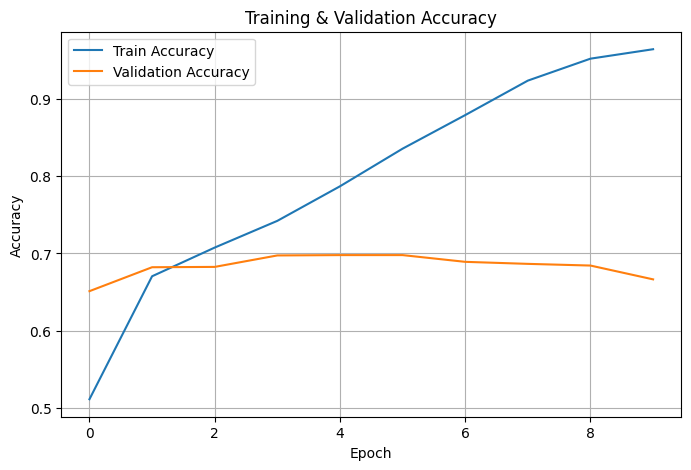

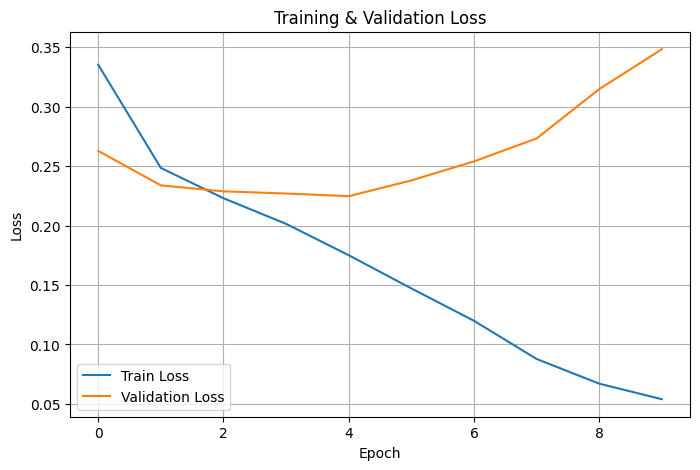

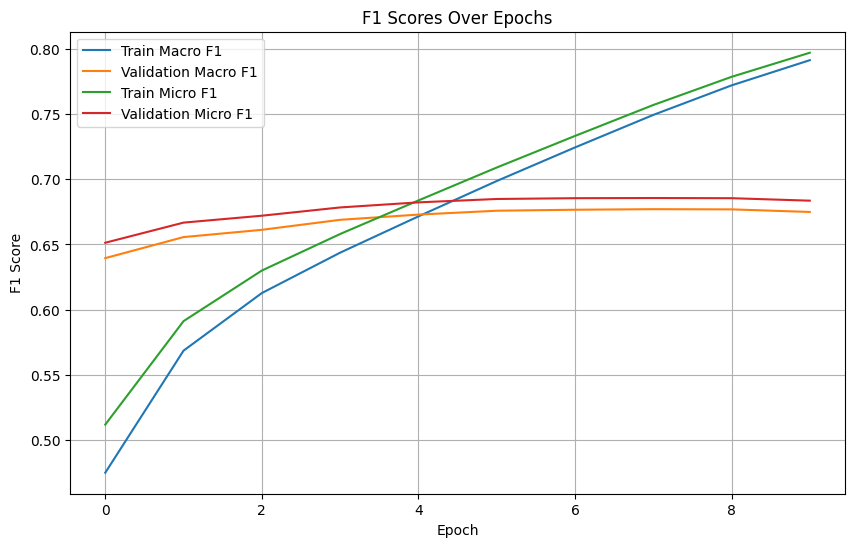

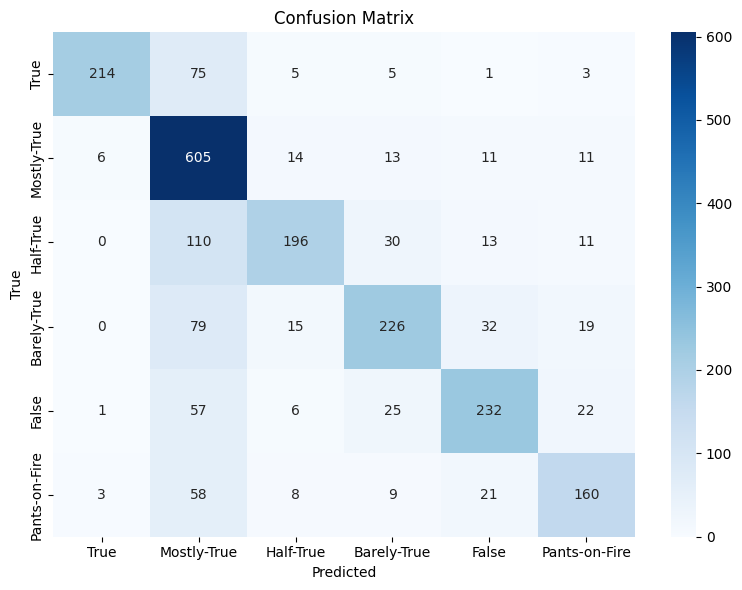

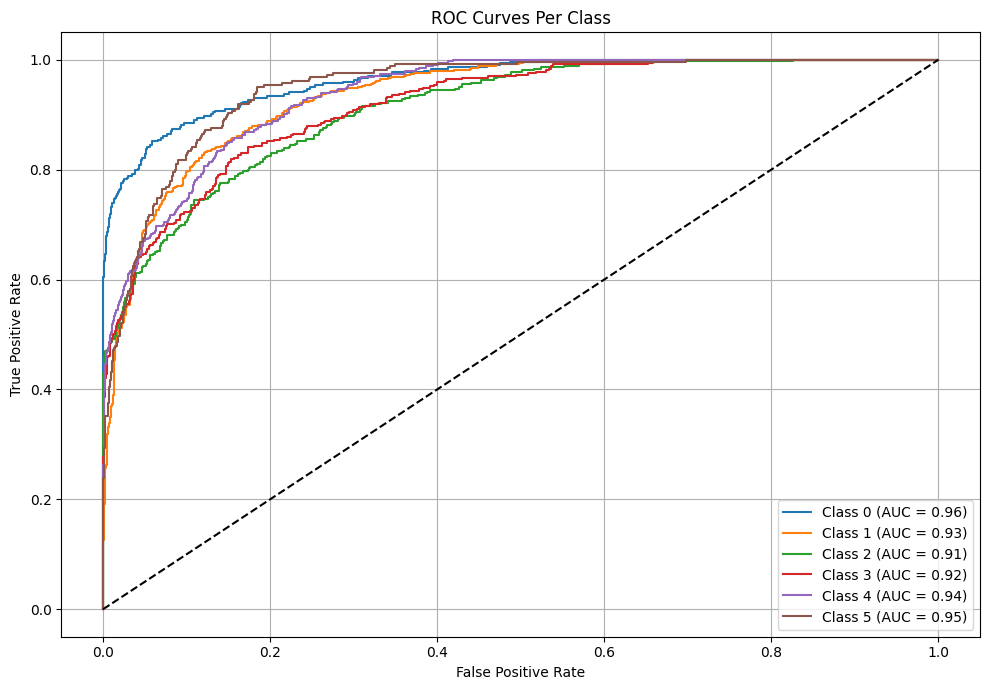

In [ ]:
plot_accuracy(Train_acc, Val_acc)
plot_loss(Train_loss, Val_loss)
plot_f1(Train_macro_f1, Val_macro_f1, Train_micro_f1, Val_micro_f1)
plot_confusion_matrix(test_label_all, test_predict_all, class_names=["True", "Mostly-True", "Half-True", "Barely-True", "False", "Pants-on-Fire"])
plot_roc_curves(np.array(test_label_onehot), np.array(test_output_probs), num_classes=6)


In [ ]:
yo